In [1]:
import os

import pandas as pd
import numpy as np
import datetime as dt
import re

from ydata_profiling import ProfileReport

# Load Data

In [2]:
path = '/home/adhitizki/playground/pacmann/pacmann_intro_ml/archive'
list_df = []

for f in os.listdir(path):
    date_data = re.sub(r'\D', '', re.search(r'_(\d{4})_(\d{2})', f).group())
    f_path = os.path.join(path, f)
    temp_df = pd.read_csv(f_path)
    temp_df['date'] = date_data
    list_df.append(temp_df)

df = pd.concat(list_df, ignore_index=True)

In [3]:
df

,id,city,type,squareMeters,rooms,floor,floorCount,buildYear,latitude,longitude,...,ownership,buildingMaterial,condition,hasParkingSpace,hasBalcony,hasElevator,hasSecurity,hasStorageRoom,price,date
0,71de9eb8a92ac12d7c94315228b70cfb,szczecin,tenement,123.45,4.0,2.0,3.0,NaN,53.432586,14.535685,...,condominium,brick,NaN,no,yes,no,no,yes,799000,202309
1,23d558163bb1c7863c73485048e50858,szczecin,NaN,53.80,2.0,5.0,5.0,NaN,53.429429,14.554642,...,cooperative,NaN,NaN,no,no,yes,no,no,420000,202309
2,3b8819c6c9ffd55adfddfd5bafcc844d,szczecin,tenement,50.00,2.0,NaN,1.0,NaN,53.364400,14.660900,...,condominium,brick,NaN,yes,no,no,no,no,350000,202309
3,708ccd264180315a4cfe6324ed4861d0,szczecin,blockOfFlats,55.19,2.0,1.0,2.0,2013.0,53.480364,14.541494,...,condominium,brick,premium,yes,yes,no,yes,yes,607000,202309
4,8373aa373dbc3fe7ca3b7434166b8766,szczecin,tenement,73.02,3.0,2.0,3.0,NaN,53.452222,14.553333,...,condominium,brick,NaN,no,no,no,no,no,565000,202309
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52587,ae88d7ea0a7a5fa0e9d287cfd78e5676,bydgoszcz,blockOfFlats,84.00,3.0,NaN,4.0,2000.0,53.112927,17.975630,...,cooperative,brick,NaN,yes,yes,no,no,yes,789000,202308
52588,6a4b30b5fcdee00bfe5bcc0da82df9b1,bydgoszcz,blockOfFlats,94.30,4.0,NaN,2.0,1998.0,53.115921,17.956396,...,condominium,NaN,NaN,no,yes,no,no,yes,699000,202308
52589,1e7f4f1fdfea31eb84e071d697839632,bydgoszcz,NaN,50.12,2.0,1.0,1.0,NaN,53.126000,18.007900,...,condominium,brick,NaN,yes,no,no,no,no,360000,202308
52590,d971c4ed3aab9919bf203e96019a678e,bydgoszcz,tenement,100.00,4.0,3.0,4.0,1910.0,53.126000,18.007900,...,condominium,brick,premium,yes,yes,no,no,yes,590000,202308


In [4]:
df.columns

Index(['id', 'city', 'type', 'squareMeters', 'rooms', 'floor', 'floorCount',
       'buildYear', 'latitude', 'longitude', 'centreDistance', 'poiCount',
       'schoolDistance', 'clinicDistance', 'postOfficeDistance',
       'kindergartenDistance', 'restaurantDistance', 'collegeDistance',
       'pharmacyDistance', 'ownership', 'buildingMaterial', 'condition',
       'hasParkingSpace', 'hasBalcony', 'hasElevator', 'hasSecurity',
       'hasStorageRoom', 'price', 'date'],
      dtype='object')

In [7]:
df.shape

(52592, 29)

In [5]:
df.head(5)

,id,city,type,squareMeters,rooms,floor,floorCount,buildYear,latitude,longitude,...,ownership,buildingMaterial,condition,hasParkingSpace,hasBalcony,hasElevator,hasSecurity,hasStorageRoom,price,date
0,71de9eb8a92ac12d7c94315228b70cfb,szczecin,tenement,123.45,4.0,2.0,3.0,NaN,53.432586,14.535685,...,condominium,brick,NaN,no,yes,no,no,yes,799000,202309
1,23d558163bb1c7863c73485048e50858,szczecin,NaN,53.80,2.0,5.0,5.0,NaN,53.429429,14.554642,...,cooperative,NaN,NaN,no,no,yes,no,no,420000,202309
2,3b8819c6c9ffd55adfddfd5bafcc844d,szczecin,tenement,50.00,2.0,NaN,1.0,NaN,53.364400,14.660900,...,condominium,brick,NaN,yes,no,no,no,no,350000,202309
3,708ccd264180315a4cfe6324ed4861d0,szczecin,blockOfFlats,55.19,2.0,1.0,2.0,2013.0,53.480364,14.541494,...,condominium,brick,premium,yes,yes,no,yes,yes,607000,202309
4,8373aa373dbc3fe7ca3b7434166b8766,szczecin,tenement,73.02,3.0,2.0,3.0,NaN,53.452222,14.553333,...,condominium,brick,NaN,no,no,no,no,no,565000,202309


# EDA

In [4]:
profile = ProfileReport(df, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Preprocess

In [8]:
# filling nan values
## filling by unknown
df['type'] = df['type'].fillna('unknown')
df['buildingMaterial'] = df['buildingMaterial'].fillna('unknown')
df['condition'] = df['condition'].fillna('unknown')

## filling elevator by floor Count because have correlation with that
temp = df[['floorCount','hasElevator']].apply(lambda x: 'no' if x[0]<=4 else 'yes', axis=1)
df['hasElevator'] = df['hasElevator'].fillna(temp)
df['hasElevator'] = df['hasElevator'].fillna('no')

## filling floor count by city and date
df['floorCount'] = df.groupby(['date', 'city'])['floorCount'].transform(lambda x: x.fillna(x.median()))

## filling build age by type and material because have good correlation
df['buildAge'] = dt.datetime.now().year - df['buildYear']
df['buildAge'] = df.groupby(['date', 'type', 'buildingMaterial'])['buildAge'].transform(lambda x: x.fillna(x.median()))
df['buildAge'] = df.groupby(['date'])['buildAge'].transform(lambda x: x.fillna(x.median()))

In [9]:
# drop columns because high correlation and avoid multicollinearity
col_drop = [
    'buildYear',
    'floor',
    'schoolDistance',
    'clinicDistance',
    'postOfficeDistance',
    'kindergartenDistance',
    'restaurantDistance',
    'collegeDistance',
    'pharmacyDistance',
    'latitude',
    'longitude',
    'id'
]

df = df.drop(columns=col_drop)

In [10]:
train_data = df[df['date']!='202310']
test_data = df[df['date']=='202310']

train_data = train_data.drop(columns=['date'])
test_data = test_data.drop(columns=['date'])

train_data

,city,type,squareMeters,rooms,floorCount,centreDistance,poiCount,ownership,buildingMaterial,condition,hasParkingSpace,hasBalcony,hasElevator,hasSecurity,hasStorageRoom,price,buildAge
0,szczecin,tenement,123.45,4.0,3.0,1.96,46.0,condominium,brick,unknown,no,yes,no,no,yes,799000,93.0
1,szczecin,unknown,53.80,2.0,5.0,0.79,60.0,cooperative,unknown,unknown,no,no,yes,no,no,420000,21.0
2,szczecin,tenement,50.00,2.0,1.0,9.32,6.0,condominium,brick,unknown,yes,no,no,no,no,350000,93.0
3,szczecin,blockOfFlats,55.19,2.0,2.0,6.46,2.0,condominium,brick,premium,yes,yes,no,yes,yes,607000,10.0
4,szczecin,tenement,73.02,3.0,3.0,3.24,9.0,condominium,brick,unknown,no,no,no,no,no,565000,93.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52587,bydgoszcz,blockOfFlats,84.00,3.0,4.0,1.96,7.0,cooperative,brick,unknown,yes,yes,no,no,yes,789000,23.0
52588,bydgoszcz,blockOfFlats,94.30,4.0,2.0,3.04,9.0,condominium,unknown,unknown,no,yes,no,no,yes,699000,25.0
52589,bydgoszcz,unknown,50.12,2.0,1.0,0.65,54.0,condominium,brick,unknown,yes,no,no,no,no,360000,27.5
52590,bydgoszcz,tenement,100.00,4.0,4.0,0.65,54.0,condominium,brick,premium,yes,yes,no,no,yes,590000,113.0


In [11]:
train_data.columns

Index(['city', 'type', 'squareMeters', 'rooms', 'floorCount', 'centreDistance',
       'poiCount', 'ownership', 'buildingMaterial', 'condition',
       'hasParkingSpace', 'hasBalcony', 'hasElevator', 'hasSecurity',
       'hasStorageRoom', 'price', 'buildAge'],
      dtype='object')

# Modelling

In [12]:
from pycaret.regression import *

reg = setup(
    data = train_data,
    target = 'price',
    imputation_type = None,
    normalize = True,
    fold = 5,
    test_data = test_data,
    session_id = 1
)

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(52592, 17)"
4,Transformed data shape,"(52592, 38)"
5,Transformed train set shape,"(35902, 38)"
6,Transformed test set shape,"(16690, 38)"
7,Ordinal features,6
8,Numeric features,6
9,Categorical features,10


In [10]:
best = compare_models(exclude = ['lightgbm'])

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,33723.3696,6156382665.6485,76307.3743,0.9477,0.0971,0.0499,1.3080
rf,Random Forest Regressor,51215.0533,7401018539.5271,84301.1623,0.9360,0.1071,0.0742,1.6900
dt,Decision Tree Regressor,43874.1844,11583340107.0387,104876.5686,0.9012,0.1331,0.0645,0.1460
xgboost,Extreme Gradient Boosting,74905.9846,12044964360.1192,108786.5500,0.8905,0.1406,0.1096,0.2000
gbr,Gradient Boosting Regressor,102140.4314,21578008371.0029,145702.1440,0.8021,0.1830,0.1485,0.8880
knn,K Neighbors Regressor,108188.1108,25214787840.3741,156839.3038,0.7758,0.1970,0.1562,0.3320
br,Bayesian Ridge,125982.6194,31342182004.4064,175085.3837,0.7189,0.2722,0.1906,0.1420
lar,Least Angle Regression,126004.5292,31342634804.1703,175091.3016,0.7188,0.2723,0.1907,0.1120
llar,Lasso Least Angle Regression,126003.7048,31342623872.0579,175091.1547,0.7188,0.2723,0.1907,0.1120
ridge,Ridge Regression,126002.6708,31342573727.0313,175090.7409,0.7188,0.2723,0.1907,0.1140


Processing:   0%|          | 0/77 [00:00<?, ?it/s]

In [13]:
et = create_model('et', fold=5, return_train_score = True)

Processing:   0%|          | 0/4 [00:00<?, ?it/s]

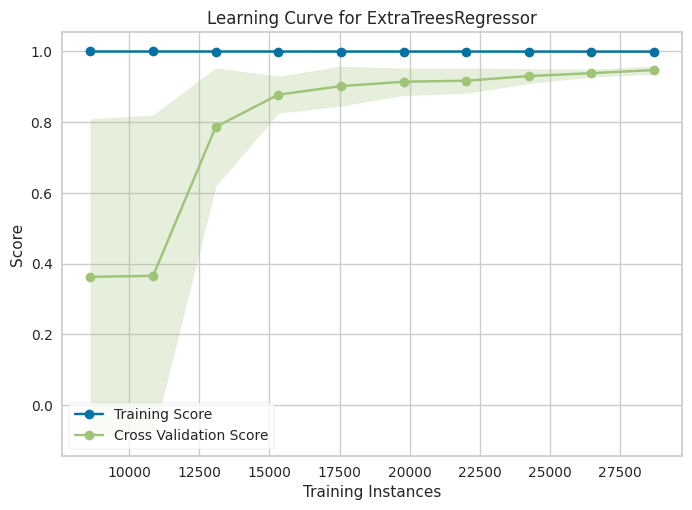

In [13]:
plot_model(et, plot='learning')

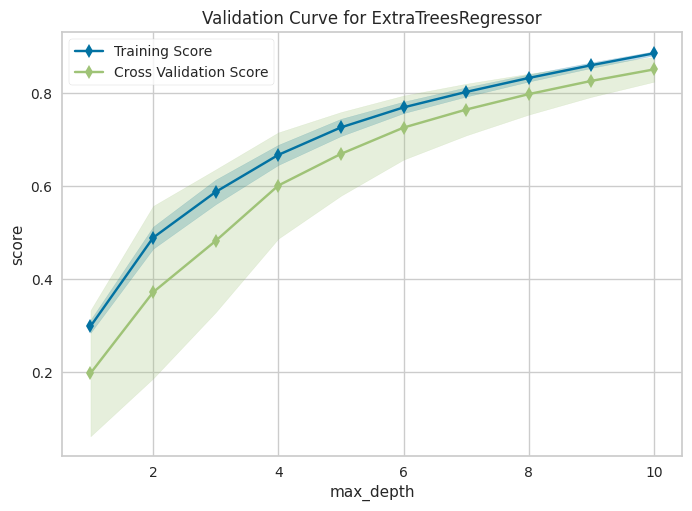

In [15]:
plot_model(et, plot='vc')

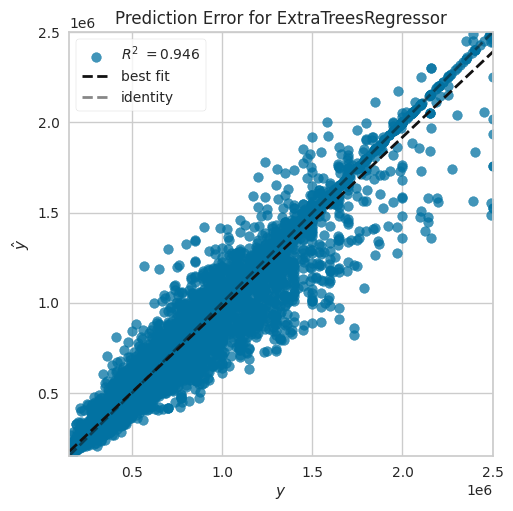

In [14]:
plot_model(et, plot='error')

In [22]:
save_model(et, 'model-pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('ordinal_encoding',
                  TransformerWrapper(include=['ownership', 'hasParkingSpace',
                                              'hasBalcony', 'hasElevator',
                                              'hasSecurity', 'hasStorageRoom'],
                                     transformer=OrdinalEncoder(cols=['ownership',
                                                                      'hasParkingSpace',
                                                                      'hasBalcony',
                                                                      'hasElevator',
                                                                      'hasSecurity',
                                                                      'hasStorageRoom'],
                                                                handle_missing='return_nan',
                                                                mapping=[{'col': 

In [11]:
create_api(et, 'model-api')

API successfully created. This function only creates a POST API, it doesn't run it automatically. To run your API, please run this command --> !python model-api.py
